# Grad-CAM Class activation visuallization guide
## Build trust on your model's decission

GRAD - Gradient weighted Class Activation Maping

**Grad-CAM** uses the gradients of any target concept, flowing into the final convolutional layer to produce a coarse localization map highlighting the important regions in the image for predicting the concept.

*Usage:*

Using Grad-CAM, we can visually validate where our network is looking, verifying that it is indeed looking at the correct patterns in the image and activating around those patterns.

If the network is not activating around the proper patterns/objects in the image, then we know:

- Our network hasn't properly learned the underlying patterns in our dataset

- Our training procedure needs to be revisited
We may need to collect additional data

- And most importantly, our model is not ready for deployment.

By [Biswajit Mohapatra](mailto:jeetmohapatra98@gmail.com)

Connect me
 - [LinkedIN](www.linkedin.com/in/biswajit-mohapatro)
 - [Github](https://github.com/biswa-mohapatra)
 - [Medium](https://medium.com/@Biswajit-Mohapatra)


In [ ]:
# Setup

import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [ ]:
# model builder
model_builder = keras.applications.xception.Xception

In [ ]:
# Specifying the image size
img_size = (299, 299)

In [ ]:
# Preprocessing:
preprocess_input = keras.applications.xception.preprocess_input

# Decoding
decode_predictions = keras.applications.xception.decode_predictions

In [ ]:
# Using the imagenet model weights
model = model_builder(weights='imagenet')
model.summary()

91884032/91884032 [==============================] - 3s 0us/step
Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 149, 149, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 149, 149, 32  128        ['block1_conv1[0][0]']           
 ation)                   

If you see the 1st layer/ input layer of the imagenet model was trained on image of 299*299, where 3 is the color grading with RGB. This is why we have mentioned our input image size as 299,299.

In [ ]:
# Lets write some functions

# our 1st task if to format our image to the format in which the
# model input layer is trained on.

def get_img_array(img_path, size):
    # `img` is a PIL image of size 299x299
    img = keras.utils.load_img(img_path, target_size=size)
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.utils.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array

# now let us write a function to draw a heatmap over the activated region.

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = keras.models.Model(
        model.inputs, [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


4217496/4217496 [==============================] - 0s 0us/step


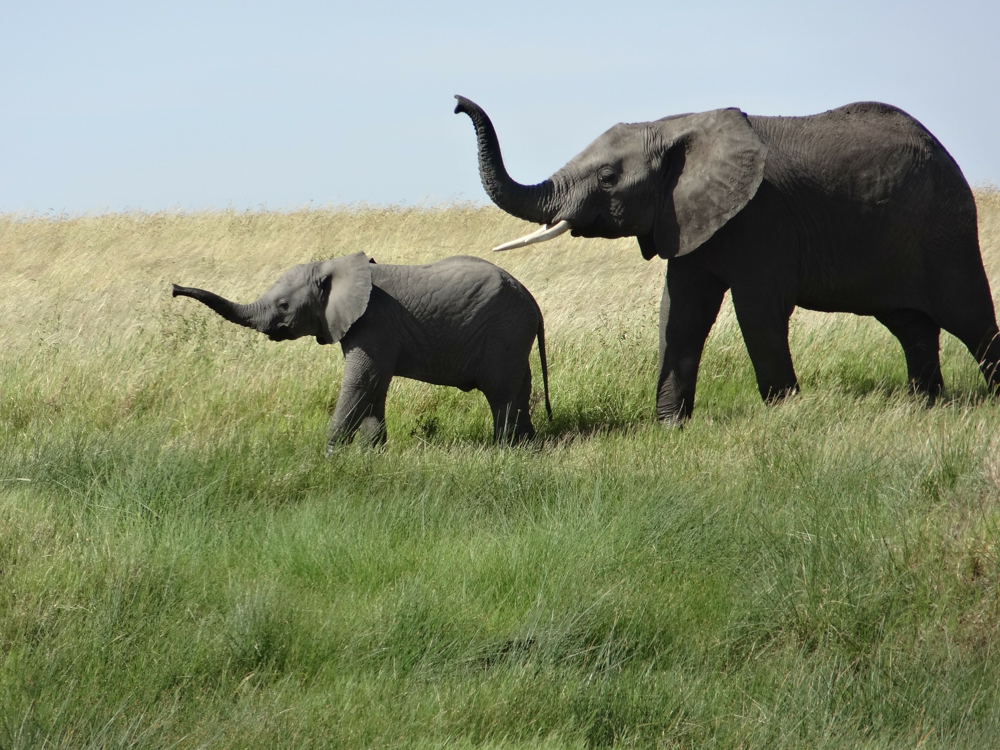

In [ ]:
# now that we have loaded the model and wrote out functions, let us test them,

last_conv_layer_name = "block14_sepconv2_act"

# The local path to our target image
img_path = keras.utils.get_file(
    "african_elephant.jpg", "https://i.imgur.com/Bvro0YD.png"
)

display(Image(img_path))

In [ ]:
# Remove last layer's softmax
model.layers[-1].activation = None

In [ ]:
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

In [ ]:
# let us check the image has been properly converted into the desired shape or not.
img_array.shape

(1, 299, 299, 3)

In [ ]:
# Print what the top predicted class is
preds = model.predict(img_array)
print("Predicted:", decode_predictions(preds, top=1)[0])

35363/35363 [==============================] - 0s 0us/step
Predicted: [('n02504458', 'African_elephant', 9.862387)]


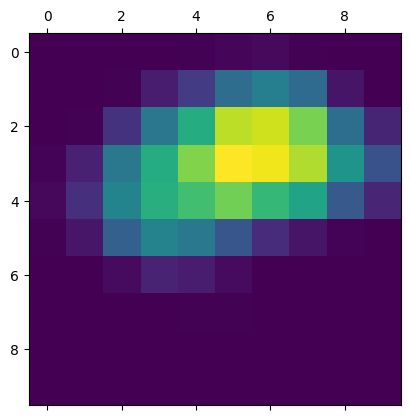

In [ ]:
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

This shows the region in the whole picture at which the model got activated for the prediction. Let us check again wether it has got activated at the proper spot in the image or not.

In [ ]:
# Let us write a function to create a supperimposed visualization

def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):
    # Load the original image
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM
    display(Image(cam_path))

<ipython-input-16-20b1952826d8>:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


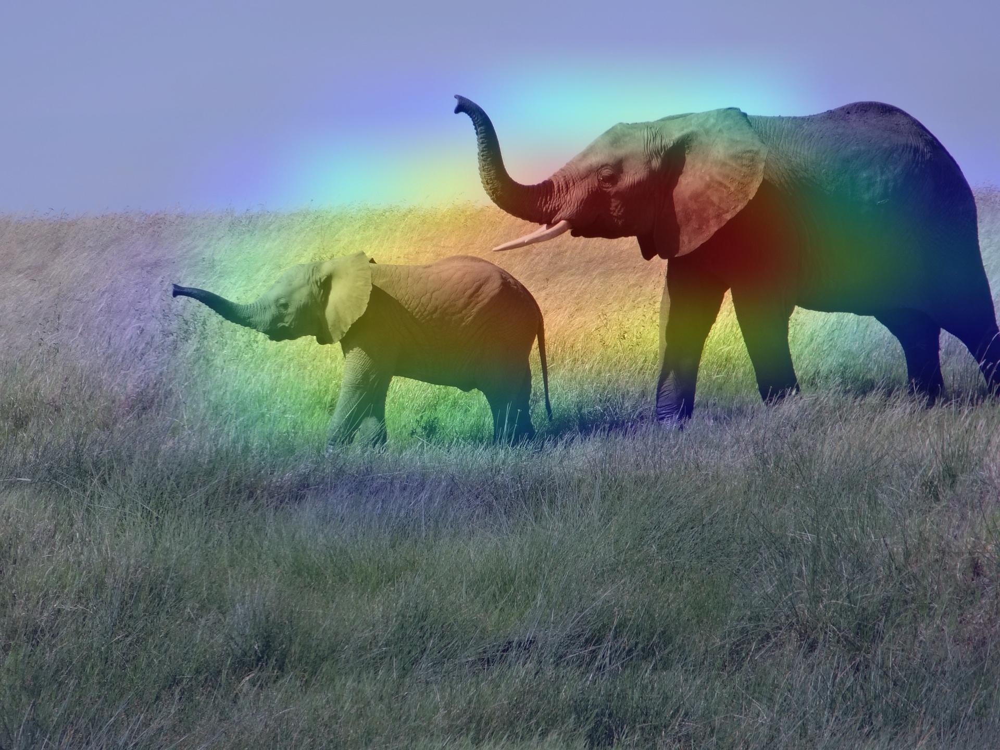

In [ ]:
save_and_display_gradcam(img_path, heatmap)

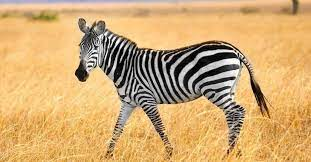

In [ ]:
# YOu can also try by one of your pictures:

img_path = '/content/download.jpg'
display(Image(img_path))

In [ ]:
# Let us follow the similar steps of preparing the image,
# predicting it and then supperimposing the activated heatmap graph on the picture.

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

# Print what the two top predicted classes are
preds = model.predict(img_array)
print("Predicted:", decode_predictions(preds, top=1)[0]) # top = 1 that is because only on object is present that i intent to predict

1/1 [==============================] - 0s 50ms/step
Predicted: [('n02391049', 'zebra', 10.277601)]


<ipython-input-16-20b1952826d8>:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


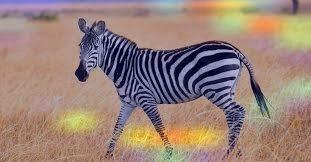

In [ ]:
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=260)

save_and_display_gradcam(img_path, heatmap)

In [ ]:
# YOu can also try by one of your pictures:

img_path = '/content/Lemon_-_whole_and_split.jpg'
display(Image(img_path))

In [ ]:
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

# Print what the two top predicted classes are
preds = model.predict(img_array)
print("Predicted:", decode_predictions(preds, top=1)[0])

1/1 [==============================] - 0s 23ms/step
Predicted: [('n07749582', 'lemon', 10.7912)]


<ipython-input-16-20b1952826d8>:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = cm.get_cmap("jet")


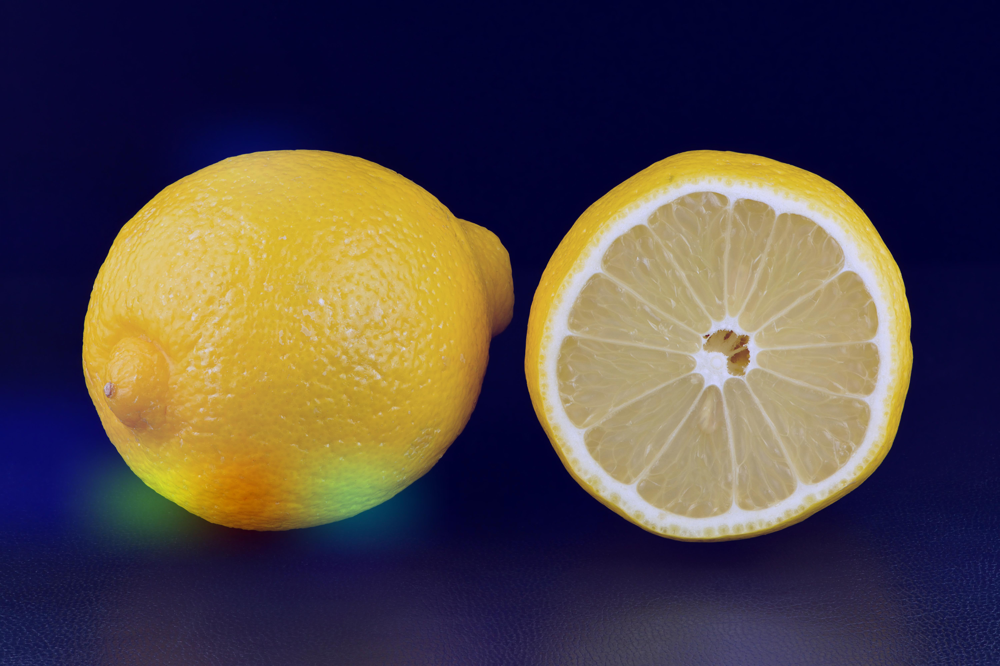

In [ ]:
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=260)

save_and_display_gradcam(img_path, heatmap)